# Experimental Data (Testing)

In [1]:
base='Geo_1ulh_pre/'
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
files=os.listdir(base)

full_files=[]
sorted_frames = sorted(files, key=lambda x: int(x[3:-4]))
for i in range(len(sorted_frames)):
    file = base+sorted_frames[i]
    full_files.append(file)

In [2]:
#torch.cuda.empty_cache()
import gc
gc.collect()

0

# Load Test Images

In [3]:
full_files[0]

'Geo_1ulh_pre/tst40.tif'

In [4]:
import cv2
import numpy as np
import cv2
from joblib import Parallel, delayed
l=448
from PIL import Image
# def process_file(file_path):
#     image = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
#     resized_image = cv2.resize(image, [l, l])
#     return resized_image
def process_file(file_path):
    image = np.array(Image.open(file_path))
    resized_image = cv2.resize(image, [l, l])
    resized_image = (resized_image-np.min(resized_image))/(np.max(resized_image)-np.min(resized_image))
    return resized_image

def parallel_image_processing(full_files):
    num_files = len(full_files)
    images = np.zeros([num_files, l, l])

    results = Parallel(n_jobs=16)(delayed(process_file)(file_path) for file_path in full_files)

    for i, resized_image in enumerate(results):
        images[i] = resized_image

    return images

images = parallel_image_processing(full_files)

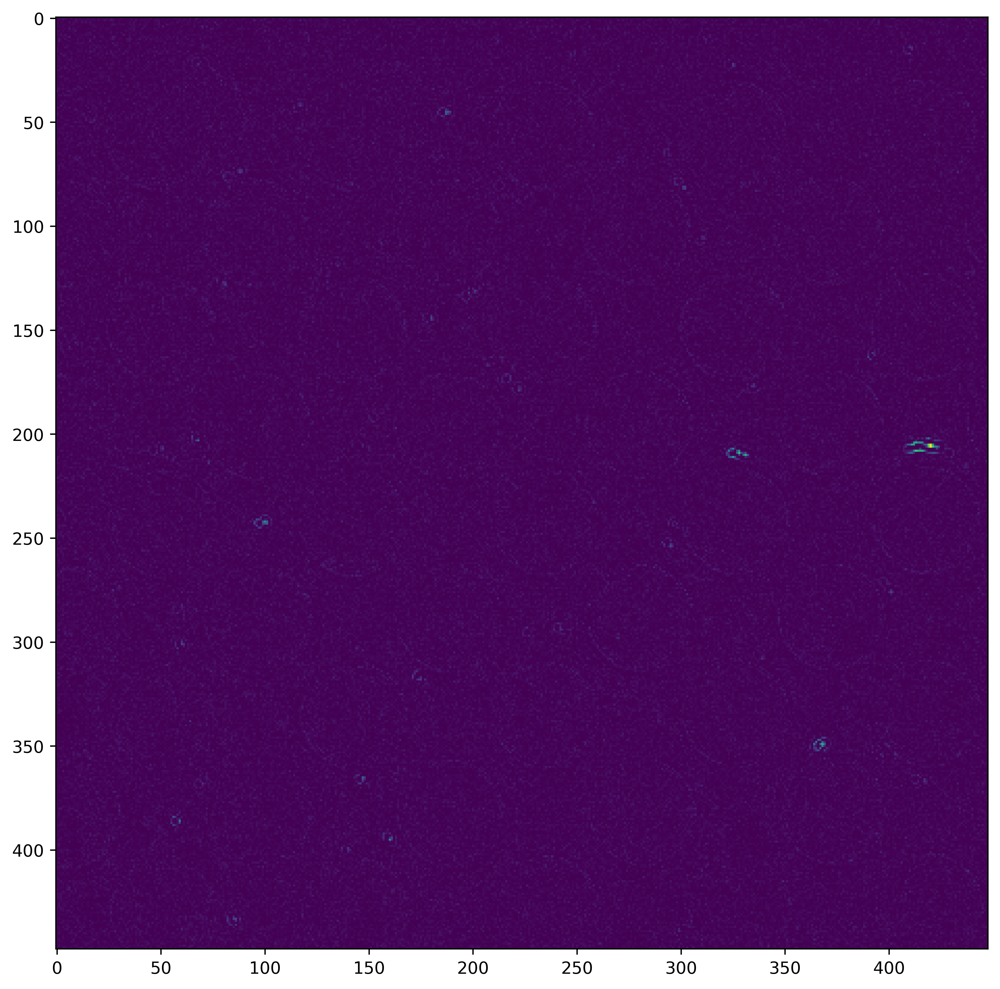

In [5]:
plt.figure(figsize=(10,10),dpi=500)
plt.imshow(images[-1])


In [48]:
# for i in range(len(images)):
#     images[i] = 1-images[i]
    

In [49]:
np.mean(images)

0.03249705450160724

In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import gc
from torch.optim.lr_scheduler import StepLR
import torchvision as tv
import timm
device='cuda'
# m1 = timm.create_model('regnety_016', in_chans=40, drop_path_rate=.0,num_classes=4000,pretrained=True)
# model=Net2()
# model.to(device)
# Define your custom dataset

class TestDataset2(Dataset):
    def __init__(self, images):
        self.images = images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image = self.images[index]

        return image.float()

In [12]:
model9 = Net0()
model9.load_state_dict(torch.load('models/speed_classifier_volod3_448px_disp200'))
model9.to(device).eval()

model10 = Net1()
model10.load_state_dict(torch.load('models/speed_classifier_volod1_384px_disp_all'))
model10.to(device).eval()

model11 = Net0()
model11.load_state_dict(torch.load('models/speed_classifier_volod3_448px_disp_all_4_25'))
model11.to(device).eval()

model12 = Net0()
model12.load_state_dict(torch.load('models/speed_classifier_volod3_448px_disp_all'))
model12.to(device).eval()

model13 = Net2()
model13.load_state_dict(torch.load('models/speed_classifier_volod1_384px_disp_all_4_25_v2'))
model13.to(device).eval()

    
model14 = timm.create_model('volo_d1_384', in_chans=40, drop_path_rate=0.6,num_classes=3,pretrained=True)
model14.load_state_dict(torch.load('models/speed_classifier_volod1_384px_disp_all_4_25'))
model14.to(device).eval()

model15 = Net7()
model15.load_state_dict(torch.load('models/speed_classifier_regnetx120_500px_disp_all'))
model15.to(device).eval()
    
model16 = Net7()
model16.load_state_dict(torch.load('models/speed_classifier_regnetx120_384px_disp_all'))
model16.to(device).eval()

model17 = Net6()
model17.load_state_dict(torch.load('models/speed_classifier_regnetx64_500px_disp_400'))
model17.to(device).eval()

model18 = Net5()
model18.load_state_dict(torch.load('models/speed_classifier_dense169_500px_disp_400'))
model18.to(device).eval()
    
model19 = Patch_model()
model19.load_state_dict(torch.load('models/speed_classifier_patch_volod1_224px_disp_all'))
model19.to(device).eval()

model20 = Net4()
model20.load_state_dict(torch.load('models/speed_classifier_volod1_224px_disp_all_v2'))
model20.to(device).eval()

model21 = Net4()
model21.load_state_dict(torch.load('models/speed_classifier_volod1_224px_disp_all'))
model21.to(device).eval()

Net4(
  (m1): VOLO(
    (patch_embed): PatchEmbed(
      (conv): Sequential(
        (0): Conv2d(40, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
        (6): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (8): ReLU(inplace=True)
      )
      (proj): Conv2d(64, 192, kernel_size=(4, 4), stride=(4, 4))
    )
    (pos_drop): Dropout(p=0.0, inplace=False)
    (network): ModuleList(
      (0): Sequential(
        (0): Outlooker(
          (norm1): LayerNorm((192,), eps=1e-05, elementwise_affine=True)
   

In [7]:
#Paen
#images = images[22:,:,:].reshape([(images.shape[0]-22)//40,40,500,500])
#Geo
#images = images[:-39,:,:].reshape([(images.shape[0]-39)//40,40,500,500])
images = images.reshape([(images.shape[0])//40,40,448,448])
images.shape

(13, 40, 448, 448)

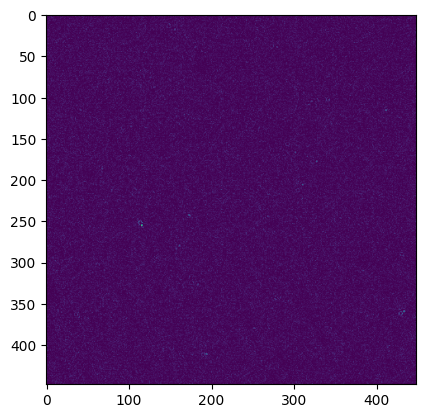

In [8]:
images = torch.tensor(images)
dataset_test = TestDataset2(images)#  xtorch_test, distr_torch_test, scales_test2)
batch_size = 2
test_dataloader = DataLoader(dataset_test, batch_size=batch_size, shuffle=False, drop_last=True, num_workers=0)
x = next(iter(test_dataloader))
plt.imshow(x[0,39,:,:])

In [53]:
model.eval()

import torchvision
outputs=[]

with torch.no_grad():
    for x in test_dataloader:
        
        out0 =(model((x).to(device)).detach().cpu().numpy())

        out = (out0)
        #out = (out11*3+out10*1+out2*2)/6

        outputs.append(out)

NameError: name 'model' is not defined

In [13]:
#model.eval()
model9.eval()
model10.eval()
model11.eval()
model12.eval()
model13.eval()
model14.eval()
model15.eval()
model16.eval()
model17.eval()
model18.eval()
model19.eval()
model20.eval()
model21.eval()
# model9.eval()
# # model10.eval()
# model11.eval()
import torchvision
outputs=[]

with torch.no_grad():
    for x in test_dataloader:
        x1 = torchvision.transforms.functional.resize(x, 448)
        x2 = torchvision.transforms.functional.resize(x, 384)
        x3 = torchvision.transforms.functional.resize(x, 224)

        #out0 =(model((x1).to(device)).detach().cpu().numpy())
        out9 =(model9((x1).to(device)).detach().cpu().numpy())
        out10 =(model10((x2).to(device)).detach().cpu().numpy())
        out11 =(model11((x1).to(device)).detach().cpu().numpy())
        out12 =(model12((x1).to(device)).detach().cpu().numpy())
        # out13_3 =(model13((x2).to(device)).detach().cpu().numpy())
        # out13 = np.zeros([batch_size,4])
        # for i in range(len(out13_3)):
        #     out13[i,:] = interpolate_vectors(out13_3[i,:],4)
        #out14 =(model14((x2).to(device)).detach().cpu().numpy())
        out15 =(model15((x).to(device)).detach().cpu().numpy())
        out16 =(model16((x2).to(device)).detach().cpu().numpy())
        out17 =(model17((x).to(device)).detach().cpu().numpy())
        out18 =(model18((x).to(device)).detach().cpu().numpy())
        out19 =(model19((x1).to(device)).detach().cpu().numpy())
        out20 =(model20((x3).to(device)).detach().cpu().numpy())
        out21 =(model21((x3).to(device)).detach().cpu().numpy())
        #out = (out10*8+out9*24+out11*2+out15*2+out18*2+out19*5+out20*5+out21*5)/60
        #out = (out11*3+out10*1+out2*2)/6
        out=(out9*27+out15*3+out21)/31

        outputs.append(out)

In [18]:
np.mean(np.vstack(outputs),0)
#15 gives .57 and .26
#18 and 21 also good
# 20 decent
out9

array([[0.01595437, 0.06139966, 0.6021973 , 0.3204487 ],
       [0.0093953 , 0.05157717, 0.05620027, 0.8828273 ]], dtype=float32)

In [66]:
np.mean(np.vstack(outputs),0)
#Geo 1ulh mean speed classified as 3 < x < 6 (class 3)
#Geo 5ulh mean speed classified as 10 < x (class 2)
#Paen 1ulh mean speed classified as x < 3 (class 4) 
#Paen 5ulh mean speed classified as 3 < x < 6 (class 3)
#Acid 1ulh mean speed classified as x < 3 (class 4) 
#outputs

array([0.00596364, 0.02139902, 0.1688502 , 0.8037872 ], dtype=float32)

In [958]:
out = np.reshape(np.hstack(outputs),[20000 ,])
out = out[out>0]
out.shape

(20000,)

In [959]:
np.mean(out)

4.785051

### Geobacter 1 = "out"

In [44]:
def interpolate_vectors(vector, target_length):
    current_length = len(vector)
    # Create a new x-axis with the desired length
    new_x = np.linspace(0, current_length - 1, target_length)
    # Create the old x-axis based on the current length
    old_x = np.arange(current_length)
    # Perform linear interpolation
    interpolated_vector = np.interp(new_x, old_x, vector)
    return interpolated_vector

In [968]:
directory='../tmate_trajectories/'
filename = os.listdir(directory)[1]
print(filename)
df = pd.read_csv(os.path.join(directory,filename),header=0, skiprows=[1,2,3])
#df.Positio
tracks = df.TRACK_ID.unique()
vels=1
for i in range(len(tracks)):
    idx = tracks[i]
    if df[df.TRACK_ID==idx].sort_values(by='FRAME').FRAME.iloc[-1] < (images.shape[0]*images.shape[1]):
        posx = .325*df[df.TRACK_ID==idx].sort_values(by='FRAME').POSITION_X
        posy = .325*df[df.TRACK_ID==idx].sort_values(by='FRAME').POSITION_Y
        
        #posx[posx==0]=np.nan
        #posy[posy==0]=np.nan
        vel = (np.sqrt(posx.diff()**2+posy.diff()**2)/.12).dropna()
    
        vels = np.hstack([vels, vel])

acid_1ulh_002.csv


In [969]:
(9*.325)/.12

24.375000000000004

In [970]:
vels=vels[~np.isnan(vels)]
vels = vels[vels<800]
vels = vels[vels>0]

In [971]:
print(np.mean(out*.325/.12))
print(np.mean(vels))

12.959513
11.272103594771446


In [791]:
out.shape

(20000,)

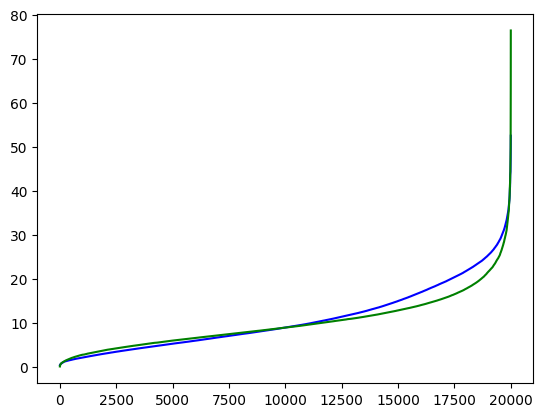

In [792]:
vels2 = interpolate_vectors(np.sort(vels), len(out))
plt.plot(np.sort(out*.325/.12), c='b')
plt.plot(np.sort(vels2), c='g')

In [251]:
out0

array([[-0.02498762,  0.0378291 ,  0.06044016, ...,  5.2131214 ,
         5.2226667 ,  6.8682303 ],
       [-0.02277473,  0.03653021,  0.06025662, ...,  5.171699  ,
         5.183982  ,  6.8211527 ],
       [-0.02291883,  0.03489473,  0.05901675, ...,  5.2576847 ,
         5.25974   ,  6.9253097 ],
       ...,
       [-0.02520523,  0.0371021 ,  0.05528578, ...,  5.0298886 ,
         5.053476  ,  6.6672807 ],
       [-0.0257259 ,  0.03689412,  0.05398463, ...,  5.01144   ,
         5.0357084 ,  6.6487713 ],
       [-0.02559044,  0.03692893,  0.0536023 , ...,  5.000195  ,
         5.0252047 ,  6.635705  ]], dtype=float32)

In [489]:
o=(np.sort(out17_2)*6+np.sort(out18_2)*2+np.sort(out19_2)*12+np.sort(out20)*3+np.sort(out8)*2.5+np.sort(out9)*2.5)/29

(4e-05, 0.1)

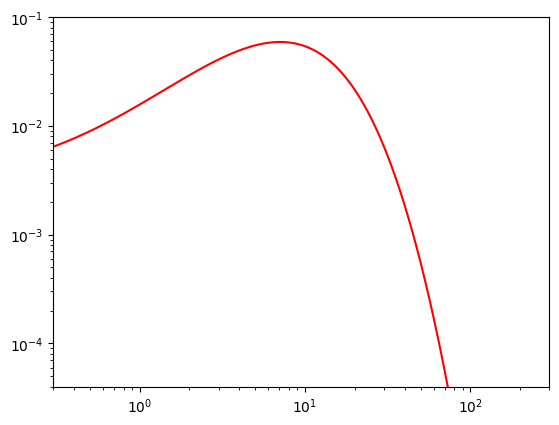

In [972]:
from scipy.stats import exponweib,lognorm, beta, betaprime, norm
#new_out=(out6*4+out2*1+out9*.5+out1*1+out10*2.5)/9
a,b,c,d= betaprime.fit(np.sort(out*.325/.12))
xtorch= np.linspace(betaprime.ppf(0.0001, a,b,c,d),
                betaprime.ppf(0.9999, a,b,c,d), 4000)
distr_torch=betaprime.pdf(xtorch, a,b,c,d)
plt.plot(xtorch,distr_torch,c='r')
plt.xscale('log')
plt.yscale('log')
plt.xlim([3e-1,3e2])
plt.ylim([4e-5,.1])
#15, 16, 20, 9, 3, 10
#3, 4, 6, 7, 12, 13, 17, 18, 19, 20

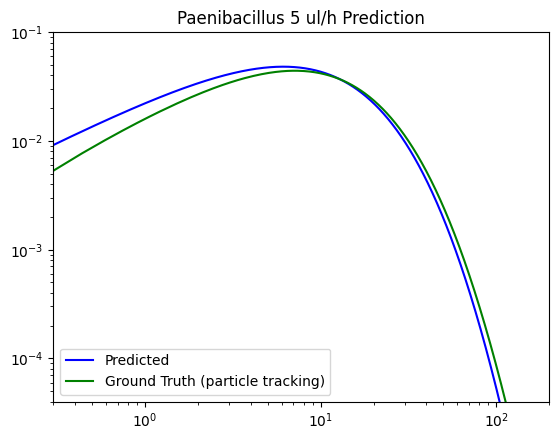

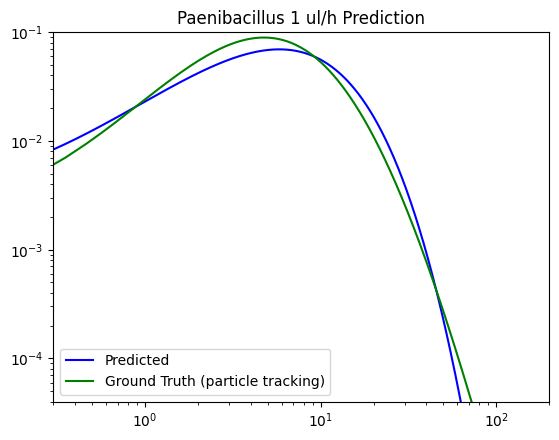

In [946]:
from scipy.stats import exponweib,lognorm, beta, betaprime, norm

a,b,c,d= betaprime.fit(np.sort(vels))
xvel= np.linspace(betaprime.ppf(0.0001, a,b,c,d),
                betaprime.ppf(0.9999, a,b,c,d), 1000)
distr_vel=betaprime.pdf(xvel, a,b,c,d)
plt.plot(xtorch,distr_torch,c='b')
plt.plot(xvel,distr_vel,c='g')
plt.xscale('log')
plt.yscale('log')
plt.xlim([3e-1,2e2])
plt.ylim([4e-5,.1])
plt.title('Paenibacillus 1 ul/h Prediction')
plt.legend(['Predicted', 'Ground Truth (particle tracking)'])

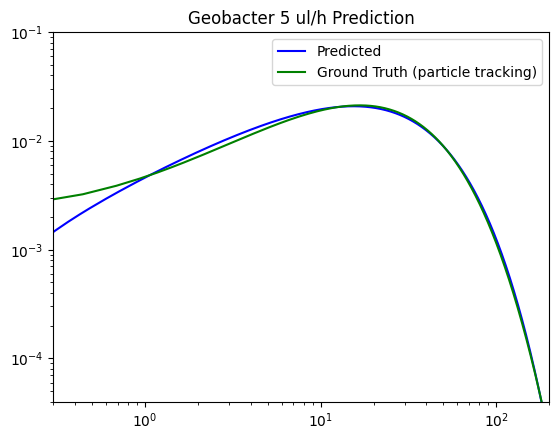

In [563]:
from scipy.stats import exponweib,lognorm, beta, betaprime, norm

a,b,c,d= betaprime.fit(np.sort(vels))
xvel= np.linspace(betaprime.ppf(0.0001, a,b,c,d),
                betaprime.ppf(0.9999, a,b,c,d), 1000)
distr_vel=betaprime.pdf(xvel, a,b,c,d)
plt.plot(xtorch,distr_torch,c='b')
plt.plot(xvel,distr_vel,c='g')
plt.xscale('log')
plt.yscale('log')
plt.xlim([3e-1,2e2])
plt.ylim([4e-5,.1])
plt.title('Geobacter 5 ul/h Prediction')
plt.legend(['Predicted', 'Ground Truth (particle tracking)'])

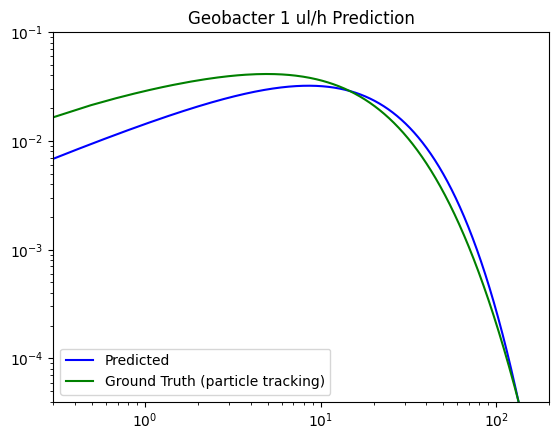

In [732]:
from scipy.stats import exponweib,lognorm, beta, betaprime, norm

a,b,c,d= betaprime.fit(np.sort(vels))
xvel= np.linspace(betaprime.ppf(0.0001, a,b,c,d),
                betaprime.ppf(0.9999, a,b,c,d), 1000)
distr_vel=betaprime.pdf(xvel, a,b,c,d)
plt.plot(xtorch,distr_torch,c='b')
plt.plot(xvel,distr_vel,c='g')
plt.xscale('log')
plt.yscale('log')
plt.xlim([3e-1,2e2])
plt.ylim([4e-5,.1])
plt.title('Geobacter 1 ul/h Prediction')
plt.legend(['Predicted', 'Ground Truth (particle tracking)'])

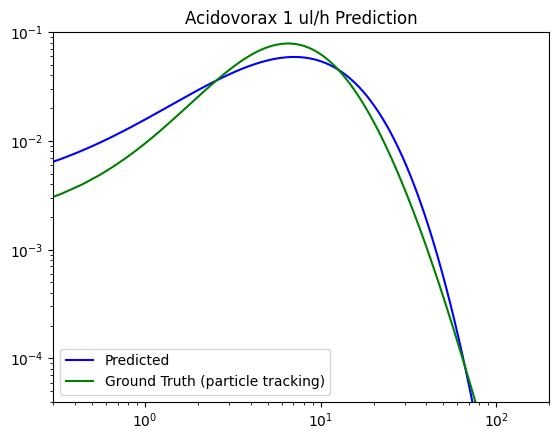

In [973]:
a,b,c,d= betaprime.fit(np.sort(vels))
xvel= np.linspace(betaprime.ppf(0.0001, a,b,c,d),
                betaprime.ppf(0.9999, a,b,c,d), 1000)
distr_vel=betaprime.pdf(xvel, a,b,c,d)
plt.plot(xtorch,distr_torch,c='b')
plt.plot(xvel,distr_vel,c='g')
plt.xscale('log')
plt.yscale('log')
plt.xlim([3e-1,2e2])
plt.ylim([4e-5,.1])
plt.title('Acidovorax 1 ul/h Prediction')
plt.legend(['Predicted', 'Ground Truth (particle tracking)'])

# Model Training

In [1]:
import os

sim_dir = os.listdir('lbm_sims')
file_dir = os.listdir('lbm_traj_files')
# Custom sorting key function
def sort_key(item):
    if '_brown' in item:
        return (1, int(item[3:-6]))
    elif 'straight' in item:
        return (2, int(item[3:-9]))
    elif 'blank' in item:
        return (3, int(item[3:-6]))
    else:
        return (0, int(item[3:]))

# Sort the list using the custom key
sorted_sim_dir = sorted(sim_dir, key=sort_key)
#sorted_sim_dir=sorted_sim_dir[0:400]
print(sorted_sim_dir)

['sim781', 'sim782', 'sim783', 'sim784', 'sim785', 'sim786', 'sim787', 'sim788', 'sim789', 'sim790', 'sim791', 'sim792', 'sim793', 'sim794', 'sim795', 'sim796', 'sim797', 'sim798', 'sim799', 'sim800', 'sim801', 'sim802', 'sim803', 'sim804', 'sim805', 'sim806', 'sim807', 'sim808', 'sim809', 'sim810', 'sim811', 'sim812', 'sim813', 'sim814', 'sim815', 'sim816', 'sim817', 'sim818', 'sim819', 'sim820', 'sim821', 'sim822', 'sim823', 'sim824', 'sim825', 'sim826', 'sim827', 'sim828', 'sim829', 'sim830', 'sim831', 'sim832', 'sim833', 'sim834', 'sim835', 'sim836', 'sim837', 'sim838', 'sim839', 'sim840', 'sim841', 'sim842', 'sim843', 'sim844', 'sim845', 'sim846', 'sim847', 'sim848', 'sim849', 'sim850', 'sim851', 'sim852', 'sim853', 'sim854', 'sim855', 'sim856', 'sim857', 'sim858', 'sim859', 'sim860', 'sim861', 'sim862', 'sim863', 'sim864', 'sim865', 'sim866', 'sim867', 'sim868', 'sim869', 'sim870', 'sim871', 'sim872', 'sim873', 'sim874', 'sim875', 'sim876', 'sim877', 'sim878', 'sim879', 'sim880',

In [2]:
import os


# Custom sorting key function
def sort_key2(item):
    if '_brown' in item:
        return (1, int(item[6:-10]))
    elif 'straight' in item:
        return (2, int(item[6:-13]))
    elif 'blank' in item:
        return (3, int(item[6:-10])) # Extract the numeric part for files with '_brown'
    else:
        return (0, int(item[6:-4]))  # Extract the numeric part for files without '_brown'

# Sort the list using the custom key
sorted_file_dir = sorted(file_dir, key=sort_key2)

# Split the sorted list into 'yc_' and 'xc_' files
yc_files = [f for f in sorted_file_dir if f.startswith('yc_')]
xc_files = [f for f in sorted_file_dir if f.startswith('xc_')]

# Create a list of lists with corresponding 'yc_' and 'xc_' files
sorted_file_pairs = [[yc, xc] for yc, xc in zip(yc_files, xc_files)]

#sorted_file_pairs=sorted_file_pairs[0:400]
print(sorted_file_pairs)

[['yc_sim781.csv', 'xc_sim781.csv'], ['yc_sim782.csv', 'xc_sim782.csv'], ['yc_sim783.csv', 'xc_sim783.csv'], ['yc_sim784.csv', 'xc_sim784.csv'], ['yc_sim785.csv', 'xc_sim785.csv'], ['yc_sim786.csv', 'xc_sim786.csv'], ['yc_sim787.csv', 'xc_sim787.csv'], ['yc_sim788.csv', 'xc_sim788.csv'], ['yc_sim789.csv', 'xc_sim789.csv'], ['yc_sim790.csv', 'xc_sim790.csv'], ['yc_sim791.csv', 'xc_sim791.csv'], ['yc_sim792.csv', 'xc_sim792.csv'], ['yc_sim793.csv', 'xc_sim793.csv'], ['yc_sim794.csv', 'xc_sim794.csv'], ['yc_sim795.csv', 'xc_sim795.csv'], ['yc_sim796.csv', 'xc_sim796.csv'], ['yc_sim797.csv', 'xc_sim797.csv'], ['yc_sim798.csv', 'xc_sim798.csv'], ['yc_sim799.csv', 'xc_sim799.csv'], ['yc_sim800.csv', 'xc_sim800.csv'], ['yc_sim801.csv', 'xc_sim801.csv'], ['yc_sim802.csv', 'xc_sim802.csv'], ['yc_sim803.csv', 'xc_sim803.csv'], ['yc_sim804.csv', 'xc_sim804.csv'], ['yc_sim805.csv', 'xc_sim805.csv'], ['yc_sim806.csv', 'xc_sim806.csv'], ['yc_sim807.csv', 'xc_sim807.csv'], ['yc_sim808.csv', 'xc_sim80

In [3]:
# from sklearn.model_selection import train_test_split

# # Create a range of numbers from 0 to 534
# indices = range(535)

# # Perform the train-test split
# train_indices, test_indices = train_test_split(indices, test_size=0.2)

In [4]:
# test_indices

In [5]:
# test_dirs = [sorted_file_pairs[i] for i in test_indices]
# train_dirs = [sorted_file_pairs[i] for i in train_indices]

# len(test_dirs)

In [6]:
train_dirs = sorted_file_pairs#[0:-100]+sorted_file_pairs[5::6]
train_dirs = sorted_file_pairs[1::5]+sorted_file_pairs[2::5]+sorted_file_pairs[3::5]+sorted_file_pairs[4::5]#+sorted_file_pairs[7::7]
len(train_dirs)
test_dirs = sorted_file_pairs[0::5]

In [7]:
# test_image_files = [sorted_sim_dir[i] for i in test_indices]
# train_image_files = [sorted_sim_dir[i] for i in train_indices]

In [8]:
train_image_files = sorted_sim_dir[1::5]+sorted_sim_dir[2::5]+sorted_sim_dir[3::5]+sorted_sim_dir[4::5]#+sorted_file_pairs[7::7]
print(len(train_dirs))
test_image_files = sorted_sim_dir[0::5]


176


In [9]:
# train_image_files = sorted_sim_dir#[0:-100]
# train_image_files = sorted_sim_dir[1::6]+sorted_sim_dir[2::6]+sorted_sim_dir[3::6]+sorted_sim_dir[4::6]+sorted_sim_dir[5::6]#+sorted_file_pairs[6::7]+sorted_file_pairs[7::7]
# len(train_dirs)
# #train_image_files = sorted_sim_dir[1::7]+sorted_sim_dir[2::7]+sorted_sim_dir[3::7]+sorted_sim_dir[4::7]+sorted_sim_dir[5::7]+sorted_sim_dir[6::7]+sorted_sim_dir[7::7]

len(train_image_files)

176

In [10]:
len(test_image_files)

44

In [11]:
len(test_dirs)

44

In [12]:
import timm

In [13]:
timm.list_models()

['bat_resnext26ts',
 'beit_base_patch16_224',
 'beit_base_patch16_384',
 'beit_large_patch16_224',
 'beit_large_patch16_384',
 'beit_large_patch16_512',
 'beitv2_base_patch16_224',
 'beitv2_large_patch16_224',
 'botnet26t_256',
 'botnet50ts_256',
 'caformer_b36',
 'caformer_m36',
 'caformer_s18',
 'caformer_s36',
 'cait_m36_384',
 'cait_m48_448',
 'cait_s24_224',
 'cait_s24_384',
 'cait_s36_384',
 'cait_xs24_384',
 'cait_xxs24_224',
 'cait_xxs24_384',
 'cait_xxs36_224',
 'cait_xxs36_384',
 'coat_lite_medium',
 'coat_lite_medium_384',
 'coat_lite_mini',
 'coat_lite_small',
 'coat_lite_tiny',
 'coat_mini',
 'coat_small',
 'coat_tiny',
 'coatnet_0_224',
 'coatnet_0_rw_224',
 'coatnet_1_224',
 'coatnet_1_rw_224',
 'coatnet_2_224',
 'coatnet_2_rw_224',
 'coatnet_3_224',
 'coatnet_3_rw_224',
 'coatnet_4_224',
 'coatnet_5_224',
 'coatnet_bn_0_rw_224',
 'coatnet_nano_cc_224',
 'coatnet_nano_rw_224',
 'coatnet_pico_rw_224',
 'coatnet_rmlp_0_rw_224',
 'coatnet_rmlp_1_rw2_224',
 'coatnet_rmlp_1_r

In [14]:
# swinv2_small_window16_256
# vit_so150m_patch16_reg4_gap_256
# maxxvitv2_nano_rw_256
# levit_conv_256d

In [17]:
import pandas as pd
import numpy as np
import cv2
import os
import torch
import re
#torch.set_default_dtype(torch.float16)

# import joblib
# import os
# import cv2
# import torch
# import re
# import numpy as np

# s = 384
# k = 40
# train_image_files = [...]  # your list of train image files
# test_image_files = [...]  # your list of test image files

# def process_image(file):
#     base = 'all_sims/' + file
#     im_dir = os.listdir(base)
#     im_dir = sorted(im_dir, key=lambda x: int(re.findall(r'\d+', x)[0]))
#     images = []
#     for j in range(k):
#         img = cv2.resize(cv2.imread(base + '/' + im_dir[j], cv2.IMREAD_GRAYSCALE), (s, s))
#         img = (img - np.min(img)) / (np.max(img) - np.min(img))
#         images.append(img)
#     return images

# images_train = joblib.Parallel(n_jobs=8)(joblib.delayed(process_image)(file) for file in train_image_files)
# images_test = joblib.Parallel(n_jobs=8)(joblib.delayed(process_image)(file) for file in test_image_files)

# # Convert the list of tensors to a tensor
# images_train = torch.stack(torch.tensor(images_train))
# images_test = torch.stack(torch.tensor(images_test))

# # Convert the list of tensors to a tensor
# images_train = torch.stack(images_train)
# images_test = torch.stack(images_test)

# train_image_files=['../500part_4xspeed_heterogeneous/','../2000part_4xspeed_heterogeneous/', '../2000part_16xspeed_heterogeneous/',
#                   '../2000part_32xspeed_heterogeneous/','../1000part_16xspeed_heterogeneous/','../500part_32xspeed_heterogeneous/',
#                   '../1000part_32xspeed_heterogeneous/', 'sim2/', 'sim11/', 'sim12/', 'sim13/', 'sim14/', 'sim19/','sim20/','sim21/',
#                    'sim22/','sim23/','sim24/','sim25/','sim35/','sim36/','sim46/','sim62/','sim63/','sim64/','sim65/','sim66/',
#                   'sim67/','sim16/']
# train_image_files=['sim62/','sim63/','sim64/','sim66/',
#                   'sim67/','sim68/','sim69/', 'sim72/','sim73/','sim74/','sim76/',
#                   'sim77/','sim78/','sim79/', 'sim82/','sim83/','sim84/','sim86/',
#                   'sim87/','sim88/','sim89/', 'sim92/','sim93/','sim94/','sim96/',
#                   'sim97/','sim98/','sim99/', 'sim102/','sim103/','sim104/','sim106/',
#                   'sim107/','sim108/','sim109/', 'sim112/','sim113/','sim114/','sim116/',
#                   'sim117/','sim118/','sim119/', 'sim122/','sim123/','sim124/','sim116/',
#                   'sim117/','sim118/','sim119/', 'sim132/','sim133/','sim134/','sim116/',
#                   'sim117/','sim118/','sim119/', 'sim142/','sim143/','sim144/','sim116/',
#                   'sim117/','sim118/','sim119/', 'sim112/','sim113/','sim114/','sim116/',
#                   'sim117/','sim118/','sim119/', 'sim112/','sim113/','sim114/','sim116/',
#                   'sim117/','sim118/','sim119/']
# test_image_files=['sim61/','sim65/','sim70/','sim71/','sim75/','sim80/','sim81/','sim85/','sim90/',
#                   'sim91/','sim95/','sim100/','sim101/','sim105/','sim110/','sim111/','sim115/','sim120/']
s=384
k=40
images_train = torch.zeros(len(train_image_files),k,s, s)
images_test = torch.zeros(len(test_image_files),k,s, s)
for i in range(len(train_image_files)):
    base = 'lbm_sims/'+train_image_files[i]
    im_dir = os.listdir(base)
    im_dir = sorted(im_dir, key=lambda x: int(re.findall(r'\d+', x)[0]))
    for j in range(k):
        
        img= torch.tensor(cv2.resize(cv2.imread(base+'/'+im_dir[j], cv2.IMREAD_GRAYSCALE),(s,s)))
        img = (img-torch.min(img))/(torch.max(img)-torch.min(img))
        images_train[i,j,:,:] = img


for i in range(len(test_image_files)):
    base = 'lbm_sims/'+test_image_files[i]
    im_dir = os.listdir(base)
    im_dir = sorted(im_dir, key=lambda x: int(re.findall(r'\d+', x)[0]))
    for j in range(k):
        
        img = torch.tensor(cv2.resize(cv2.imread(base+'/'+im_dir[j], cv2.IMREAD_GRAYSCALE),(s,s)))
        img = (img-torch.min(img))/(torch.max(img)-torch.min(img))
        images_test[i,j,:,:] = img
        
im_dir

['Fig_1.jpg',
 'Fig_2.jpg',
 'Fig_3.jpg',
 'Fig_4.jpg',
 'Fig_5.jpg',
 'Fig_6.jpg',
 'Fig_7.jpg',
 'Fig_8.jpg',
 'Fig_9.jpg',
 'Fig_10.jpg',
 'Fig_11.jpg',
 'Fig_12.jpg',
 'Fig_13.jpg',
 'Fig_14.jpg',
 'Fig_15.jpg',
 'Fig_16.jpg',
 'Fig_17.jpg',
 'Fig_18.jpg',
 'Fig_19.jpg',
 'Fig_20.jpg',
 'Fig_21.jpg',
 'Fig_22.jpg',
 'Fig_23.jpg',
 'Fig_24.jpg',
 'Fig_25.jpg',
 'Fig_26.jpg',
 'Fig_27.jpg',
 'Fig_28.jpg',
 'Fig_29.jpg',
 'Fig_30.jpg',
 'Fig_31.jpg',
 'Fig_32.jpg',
 'Fig_33.jpg',
 'Fig_34.jpg',
 'Fig_35.jpg',
 'Fig_36.jpg',
 'Fig_37.jpg',
 'Fig_38.jpg',
 'Fig_39.jpg',
 'Fig_40.jpg']

In [18]:
import matplotlib.pyplot as plt
#plt.imshow(images_train[100,30,:,:])
images_train.shape

torch.Size([176, 40, 384, 384])

In [19]:
import gc
del im_dir
gc.collect()

669

In [62]:
import pandas as pd
import numpy as np
import cv2
import os
import torch
import re
import matplotlib.pyplot as plt
from scipy.stats import exponweib,lognorm

def interpolate_vectors(vector, target_length):
    current_length = len(vector)
    # Create a new x-axis with the desired length
    new_x = np.linspace(0, current_length - 1, target_length)
    # Create the old x-axis based on the current length
    old_x = np.arange(current_length)
    # Perform linear interpolation
    interpolated_vector = np.interp(new_x, old_x, vector)
    return interpolated_vector
    

base='lbm_traj_files/'
target_length=500
speeds = torch.zeros(len(train_dirs),target_length)
for i in range(len(train_dirs)):
    x_arr= np.array(pd.read_csv(base+train_dirs[i][1], header=None))
    y_arr= np.array(pd.read_csv(base+train_dirs[i][0], header=None))
    vx = np.diff(x_arr, axis=0)
    vy = np.diff(y_arr, axis=0)
    speed = np.sqrt(vx**2+vy**2)
    speed = np.reshape(speed, [-1])
    speed=speed[~np.isnan(speed)]
    speed = speed[speed>0]
    speed = interpolate_vectors(np.sort(speed), target_length)
    speeds[i,:] = torch.tensor(speed)
    #speed[speed<=0]=0.0001
 #   if np.mean(speed)>25:
 #       speeds[i,0] = 1
 #   elif np.mean(speed)>16:
 #       speeds[i,1] = 1
 #   elif np.mean(speed)>10:
 #       speeds[i,2] = 1
 #   elif np.mean(speed)>5:
 #       speeds[i,3] = 1
 #   else:
 #       speeds[i,4] =1


In [60]:
# xtorch_test = torch.zeros(len(test_dirs),1000)
# distr_torch_test = torch.zeros(len(test_dirs),1000)

# test_dirs=[["xc_1000part_4xspeed.csv","yc_1000part_4xspeed.csv"],["xc_500part_16xspeed.csv","yc_500part_16xspeed.csv"],
#           ['yc_sim17.csv','xc_sim17.csv'],['yc_sim18.csv','xc_sim18.csv'], ['yc_sim40.csv','xc_sim40.csv'], ['yc_sim41.csv','xc_sim41.csv'], 
#            ['yc_sim42.csv','xc_sim42.csv'], ['yc_sim43.csv','xc_sim43.csv'], ['yc_sim44.csv','xc_sim44.csv'], ['yc_sim45.csv','xc_sim45.csv'],
#            ['yc_sim69.csv','xc_sim69.csv'],['yc_sim70.csv','xc_sim70.csv'],
# ]
# test_dirs=[ ['yc_sim61.csv','xc_sim61.csv'], ['yc_sim65.csv','xc_sim65.csv'],['yc_sim70.csv','xc_sim70.csv'],
#            ['yc_sim71.csv','xc_sim71.csv'], ['yc_sim75.csv','xc_sim75.csv'],['yc_sim80.csv','xc_sim80.csv'],
#            ['yc_sim81.csv','xc_sim81.csv'], ['yc_sim85.csv','xc_sim85.csv'],['yc_sim90.csv','xc_sim90.csv'],
# ]
# scales_test = torch.zeros(len(test_dirs),3)
target_length=500
speeds_test = torch.zeros(len(test_dirs),target_length)
for i in range(len(test_dirs)):
    x_arr= np.array(pd.read_csv(base+test_dirs[i][1], header=None))
    y_arr= np.array(pd.read_csv(base+test_dirs[i][0], header=None))
    vx = np.diff(x_arr, axis=0)
    vy = np.diff(y_arr, axis=0)
    speed = np.sqrt(vx**2+vy**2)
    speed = np.reshape(speed, [-1])
    speed=speed[~np.isnan(speed)]
    speed = speed[speed>0]
    speed = interpolate_vectors(np.sort(speed), target_length)
    speeds_test[i,:] = torch.tensor(speed)
    #speed[speed<=0]=0.0001
    #print(np.mean(speed))
    #if np.mean(speed)>25:
    #    speeds_test[i,0] = 1
    #elif np.mean(speed)>16:
    #    speeds_test[i,1] = 1
    #elif np.mean(speed)>10:
    #    speeds_test[i,2] = 1
    #elif np.mean(speed)>5:
    #    speeds_test[i,3] = 1
    #else:
    #    speeds_test[i,4] =1


In [61]:
# speeds_test[-1] = torch.tensor([0,0,0,1])
speeds_test

tensor([[3.3835e-02, 2.8557e-01, 3.9528e-01,  ..., 3.1319e+01, 3.2177e+01,
         4.1158e+01],
        [9.7646e-02, 2.7468e-01, 4.3430e-01,  ..., 5.7848e+01, 6.0372e+01,
         8.3145e+01],
        [2.6669e-02, 4.6559e-01, 6.4788e-01,  ..., 2.7664e+01, 3.5343e+01,
         4.1386e+01],
        ...,
        [6.8038e-02, 1.4937e-01, 1.7473e-01,  ..., 4.3403e+01, 4.4840e+01,
         4.7855e+01],
        [4.8094e-02, 7.8922e-02, 1.0242e-01,  ..., 3.6064e+01, 3.7399e+01,
         3.8987e+01],
        [9.3958e-02, 1.6474e-01, 1.9391e-01,  ..., 9.0890e+01, 9.1831e+01,
         1.0160e+02]])

In [20]:
# speeds

In [24]:
import timm
timm.list_models()

['bat_resnext26ts',
 'beit_base_patch16_224',
 'beit_base_patch16_384',
 'beit_large_patch16_224',
 'beit_large_patch16_384',
 'beit_large_patch16_512',
 'beitv2_base_patch16_224',
 'beitv2_large_patch16_224',
 'botnet26t_256',
 'botnet50ts_256',
 'caformer_b36',
 'caformer_m36',
 'caformer_s18',
 'caformer_s36',
 'cait_m36_384',
 'cait_m48_448',
 'cait_s24_224',
 'cait_s24_384',
 'cait_s36_384',
 'cait_xs24_384',
 'cait_xxs24_224',
 'cait_xxs24_384',
 'cait_xxs36_224',
 'cait_xxs36_384',
 'coat_lite_medium',
 'coat_lite_medium_384',
 'coat_lite_mini',
 'coat_lite_small',
 'coat_lite_tiny',
 'coat_mini',
 'coat_small',
 'coat_tiny',
 'coatnet_0_224',
 'coatnet_0_rw_224',
 'coatnet_1_224',
 'coatnet_1_rw_224',
 'coatnet_2_224',
 'coatnet_2_rw_224',
 'coatnet_3_224',
 'coatnet_3_rw_224',
 'coatnet_4_224',
 'coatnet_5_224',
 'coatnet_bn_0_rw_224',
 'coatnet_nano_cc_224',
 'coatnet_nano_rw_224',
 'coatnet_pico_rw_224',
 'coatnet_rmlp_0_rw_224',
 'coatnet_rmlp_1_rw2_224',
 'coatnet_rmlp_1_r

In [23]:
from torch import nn
import torch.nn.functional as F

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        l=200
        self.fc2=nn.Conv2d(100, l, 1, stride=2)
        #self.m1 = nn.BatchNorm1d(1000)
        self.d1 = nn.Dropout(.2)
        self.fc1=nn.Conv2d(40, 100, 1, stride=2)
        #self.m2 = nn.BatchNorm1d(l)
        self.d2 = nn.Dropout(.2)
       # self.fc2 = nn.Linear(800,l)
       # self.fc3=nn.Linear(2000,800)
       # self.fc4 = nn.Linear(800,l)
        self.fc5 = nn.Conv2d(l, 5,1, stride=1)
        #self.m3 = nn.BatchNorm1d(100)
        self.fc6 = nn.Linear(312500,1000)
        self.d3 = nn.Dropout(.2)
        self.fc7 = nn.Linear(100,4)
        self.fc8 = nn.Linear(2000,1000)

    def forward(self, x):
        b = x.shape[0]
        x = x.squeeze()
        
        l=200
        x = F.relu(self.fc1(x))
        #x = self.m1(x)
        x = self.d1(x)
        x = F.relu(self.fc2(x))
        #x = self.m2(x)
        x = self.d2(x)
        #x = x.permute(0,2,1)
        #x = F.relu(self.fc3(x))
        #x = F.relu(self.fc4(x))
        
        #x = x.view(b,l*666)
        x = F.relu(self.fc5(x))
        #x = self.m3(x)
        x = x.reshape(b, -1)
        #x = F.relu(self.fc4(x))
        x = (self.fc6(x))
        # x = self.d3(x)
        # #x = torch.flatten(x)
        # x = (self.fc8(x))
        # x = x.reshape(2,200)
        #x = self.fc7(x)
        #output = nn.functional.log_softmax(x, dim=1)
        return x

import torchvision

class Patch_model(nn.Module):
    def __init__(self):
        super(Patch_model, self).__init__()
        self.m1 = timm.create_model('volo_d1_224', in_chans=40, drop_path_rate=0.5,num_classes=500,pretrained=True)
        self.m2 = timm.create_model('volo_d1_224', in_chans=40, drop_path_rate=0.5,num_classes=500,pretrained=True)
        self.m3 = timm.create_model('volo_d1_224', in_chans=40, drop_path_rate=0.5,num_classes=500,pretrained=True)
        self.m4 = timm.create_model('volo_d1_224', in_chans=40, drop_path_rate=0.5,num_classes=500,pretrained=True)


        self.fc0=nn.Linear(2000,200)
        self.fc1=nn.Linear(200,4)
        #self.fc2=nn.Linear(1000,500)


    def forward(self, x):
        l2=224
        x1 = x[:,:,0:l2,0:l2]
        x2 = x[:,:,0:l2,l2:]
        x3 = x[:,:,l2:,0:l2]
        x4 = x[:,:,l2:,l2:]
        #torch.cuda.empty_cache()
        #gc.collect()
        #x = F.gelu(self.m0(x))
        x1 = (self.m1(x1))
        x2 = (self.m2(x2))
        x3 = (self.m3(x3))
        x4 = (self.m4(x4))
        
        #x4 = F.gelu(self.m4(x4))
        x = torch.cat([x1,x2,x3,x4],dim=1)
       # del x1,x2, x3, x4
        #x0 = F.gelu(self.fc0(x0))
        #x = torch.cat([x,x0],dim=1)#x*x0
        #x = F.gelu(self.fc0(x))
        x = F.gelu(self.fc0(x))

        x = F.softmax(self.fc1(x),dim=1)


        return x#,x2,x3,x4\


class Net7(nn.Module):
    def __init__(self):
        super(Net7, self).__init__()
        self.m1 = timm.create_model('regnetx_160.pycls_in1k', in_chans=40,drop_path_rate=0.6, num_classes=4,pretrained=True)

    def forward(self, x):
        x = F.softmax(self.m1(x),dim=1)
        return x


class Net6(nn.Module):
    def __init__(self):
        super(Net6, self).__init__()
        self.m1 = timm.create_model('regnetx_064', in_chans=40,drop_path_rate=0.4, num_classes=4,pretrained=True)

    def forward(self, x):
        x = F.softmax(self.m1(x),dim=1)
        return x
    
class Net5(nn.Module):
    def __init__(self):
        super(Net5, self).__init__()
        self.m1 = timm.create_model('densenet169', in_chans=40, num_classes=4,pretrained=True)

    def forward(self, x):
        x = F.softmax(self.m1(x),dim=1)
        return x

class Net4(nn.Module):
    def __init__(self):
        super(Net4, self).__init__()
        self.m1 = timm.create_model('volo_d1_224', in_chans=40, drop_path_rate=0.9,num_classes=4,pretrained=True)

    def forward(self, x):
        x = F.softmax(self.m1(x),dim=1)
        return x
        
class Net2(nn.Module):
    def __init__(self):
        super(Net2, self).__init__()
        self.m1 = timm.create_model('volo_d1_384', in_chans=40, drop_path_rate=0.6,num_classes=3,pretrained=True)

    def forward(self, x):
        x = F.softmax(self.m1(x),dim=1)
        return x
    
class Net0(nn.Module):
    def __init__(self):
        super(Net0, self).__init__()
        self.m1 = timm.create_model('volo_d3_448', in_chans=40, drop_path_rate=0.8,num_classes=4,pretrained=True)

    def forward(self, x):
        x = F.softmax(self.m1(x),dim=1)
        return x

class Net1(nn.Module):
    def __init__(self):
        super(Net1, self).__init__()
        self.m1 = timm.create_model('volo_d1_384', in_chans=40, drop_path_rate=0.6,num_classes=4,pretrained=True)

    def forward(self, x):
        x = F.softmax(self.m1(x),dim=1)
        return x
    
class Net3(nn.Module):
    def __init__(self):
        super(Net3, self).__init__()
        l=80

        self.fc1=nn.Linear(1000,l)
        self.d1 = nn.Dropout(.1)
        self.fc2=nn.Linear(1000,l)
        self.d2 = nn.Dropout(.1)
        self.fc3 = nn.Linear(40*l*l,1000)
        self.d3 = nn.Dropout(.1)
        self.fc4 = nn.Linear(1000,250)
        self.fc4_2 = nn.Linear(250,1000)
#         self.fc4_3 = nn.Linear(800,300)
#         self.fc5 = nn.Linear(300,30)
# #         self.fc5_2 = nn.Linear(200,100)
# #         self.fc5_3 = nn.Linear(100,30)
#         self.fc6 = nn.Linear(30,3)

    def forward(self, x):
        b = x.shape[0]
        x = F.relu(self.fc1(x))
        x = self.d1(x)
        x = x.permute(0,1,3,2)
        x = F.relu(self.fc2(x))
        x = self.d2(x)
        x = torch.reshape(x, [b,-1])
        x = F.relu(self.fc3(x))
        x = self.d3(x)
        x = F.relu(self.fc4(x))
        #x = torch.reshape(x, [b,10000])
        x = (self.fc4_2(x))
#         x = F.rrelu(self.fc4_3(x))
#         x = F.rrelu(self.fc5(x))
# #         x = F.rrelu(self.fc5_2(x))
# #         x = F.rrelu(self.fc5_3(x))
#         x = self.fc6(x)
        #x = torch.reshape(x, [b,2,100])
        #x = self.fc7(x)
        #output = nn.functional.log_softmax(x, dim=1)
        return x

In [23]:
images_train=1-images_train
images_test=1-images_test

In [24]:
# images_train=images_train/255
# images_test=images_test/255
torch.mean(images_test[0])

tensor(0.2154)

tensor(0.)

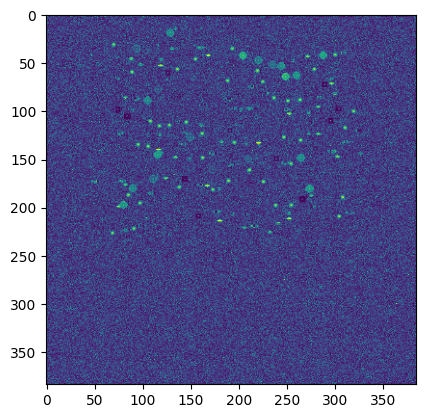

In [63]:
import matplotlib.pyplot as plt
plt.imshow(images_train[1,10,:,:])
torch.min(images_train[-10,0,:,:])

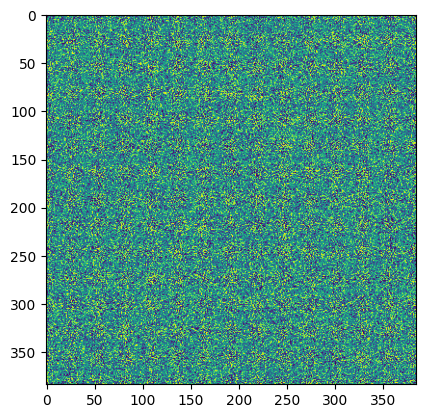

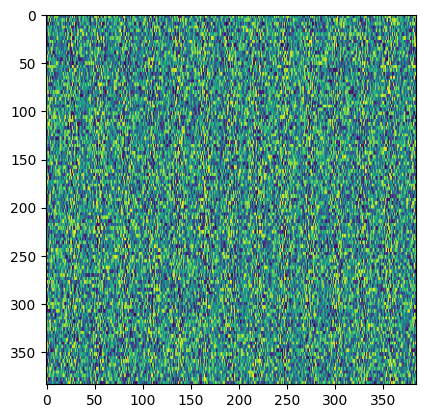

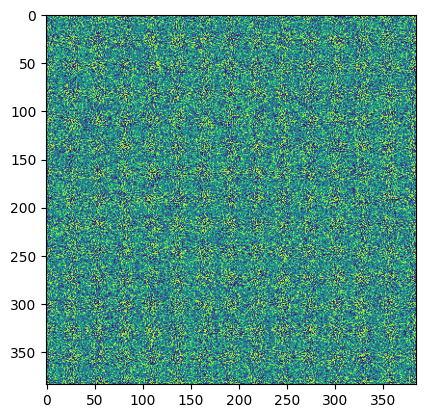

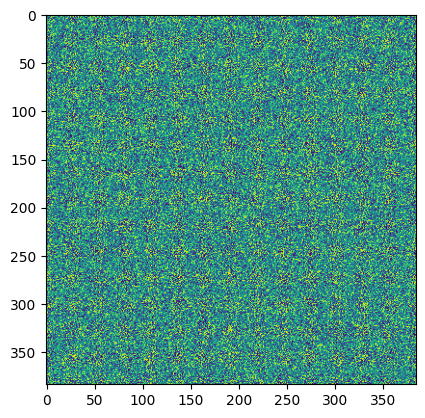

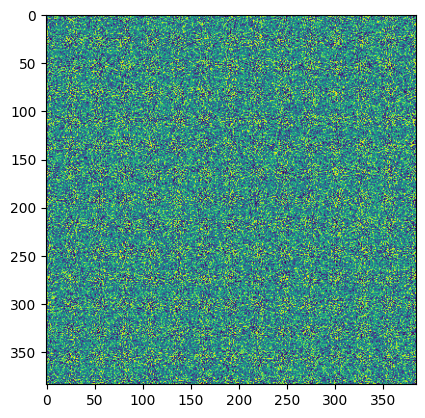

...

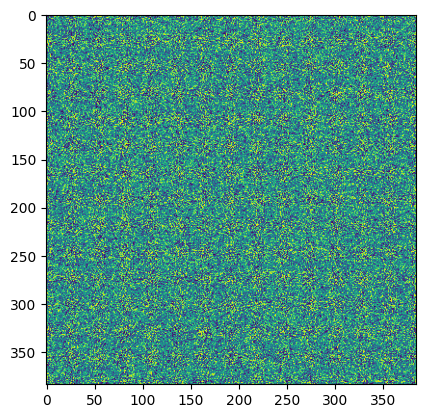

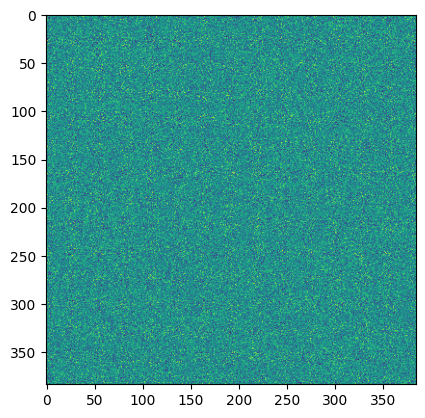

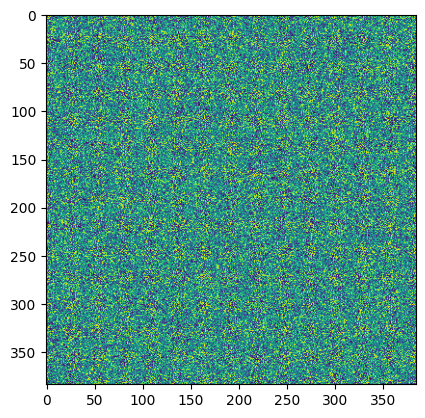

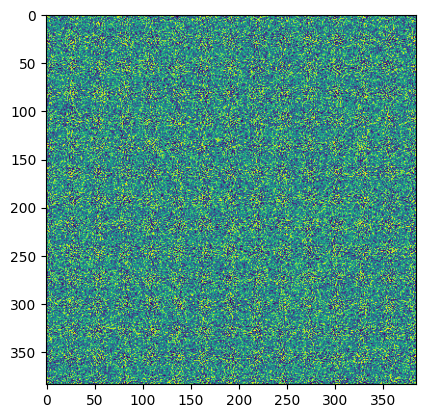

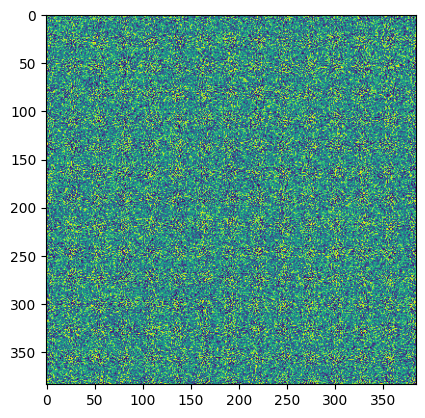

KeyboardInterrupt: 

In [24]:
from torchvision.transforms import v2
import torch
import matplotlib.pyplot as plt
import albumentations as A
import numpy as np
import timm
H, W = 384, 384
for n in range(20):
    img = torch.randint(0, 256, size=(40, H, W), dtype=torch.uint8)
    
    transform = A.Compose([
    
        #A.RandomRotate90(p=.5),
        A.OneOf([
            A.Flip(0,p=.33),
            A.Flip(1,p=.33),
            A.Flip(p=.33),
        ], p=0.5),
        A.OneOf([
            A.MotionBlur(p=0.5),
            A.Blur(blur_limit=3, p=0.5),
        ], p=0.4),
        A.Downscale(scale_min=0.2, scale_max=0.8, p=.4),
        A.GaussNoise(.02,p=.3),
        A.InvertImg(p=.5),
        #A.PixelDropout(p=.5), 
    ])
    plt.imshow(img[0])
    plt.show()
    #img = transform(img)
    augmented = transform(image=np.array(img))
    plt.imshow(augmented['image'][10,:,:])
    plt.show()


In [26]:
augmented['image'].shape

(40, 384, 384)

In [27]:
import timm
device='cuda'
x=torch.tensor(augmented['image']).to(device)
model = timm.create_model('volo_d1_384', in_chans=40,drop_path_rate=.6, num_classes=4,pretrained=True)
model.to(device)
model(x.unsqueeze(0).float())

tensor([[ 0.4275, -0.1877,  0.3661,  0.1761]], device='cuda:0',
       grad_fn=<AddBackward0>)

In [2]:
plt.imshow(images_train[1,35])
plt.show()
plt.imshow(augmented['image'][35,:,:])
plt.show()

NameError: name 'plt' is not defined

In [49]:
F.sigmoid(outputs)

tensor([[0.4666, 0.6810, 0.5327, 0.3876, 0.3680],
        [0.4275, 0.6871, 0.5283, 0.3828, 0.3703],
        [0.4773, 0.6865, 0.5279, 0.4208, 0.3541],
        [0.4234, 0.7055, 0.5395, 0.3983, 0.3629],
        [0.4941, 0.6849, 0.5320, 0.3874, 0.3882],
        [0.4422, 0.7073, 0.5267, 0.3952, 0.3506],
        [0.4740, 0.6582, 0.5007, 0.3979, 0.4316],
        [0.4602, 0.7095, 0.5169, 0.3951, 0.3780],
        [0.4178, 0.6962, 0.5292, 0.3910, 0.3626],
        [0.4344, 0.6832, 0.5283, 0.3841, 0.3731]], device='cuda:0',
       grad_fn=<SigmoidBackward0>)

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import gc
from torch.optim.lr_scheduler import StepLR
import torchvision as tv
import timm
import albumentations as A
import numpy as np
device='cuda'
import torch.nn.functional as F

model = timm.create_model('volo_d1_384', in_chans=40,drop_path_rate=.5, num_classes=500,pretrained=True)
#model=Net7()
model.to(device)
torch.cuda.empty_cache()
gc.collect()

class TestDataset(Dataset):
    def __init__(self, images, x):
        self.images = images
        self.x = x

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image = self.images[index,:,:,:]
        x = self.x[index,:]
        return image.float(), x.float()
        
import random
class TrainDataset(Dataset):
    def __init__(self, images, x):
        self.images = images
        self.x = x

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image = self.images[index,:,:,:]
        transform = A.Compose([
    
        #A.RandomRotate90(p=.5),
        A.OneOf([
            A.Flip(0,p=.33),
            A.Flip(1,p=.33),
            A.Flip(p=.33),
        ], p=0.4),
        A.OneOf([
            A.MotionBlur(p=0.5),
            A.Blur(blur_limit=3, p=0.5),
        ], p=0.4),
        A.Downscale(scale_min=0.2, scale_max=0.8, p=.4),
        A.GaussNoise(.02,p=.4),
        A.InvertImg(p=.5),
        #A.PixelDropout(p=.5), 
        ])
        # augmented = transform(image=np.array(image))
        # if augmented['image'].shape[0]!=384:
        #     image = torch.tensor(augmented['image'])
        # else:
        #     image = torch.tensor(np.transpose(augmented['image'],(1,0,2)))
        image = torch.tensor(augmented['image'])
        if random.random() < 0.4:
            image = image.flip(dims=[-1]) 
        if random.random() < 0.4:
            image = image.flip(dims=[-2])  # Assuming W=50 is the middle axis for flipping
        
        if random.random() < 0.5:
            image = image.flip(dims=[-3])  # Flipping the last dimension (H)
        

        x = self.x[index,:]
        return image.float(), x.float()


# Define your model architecture

import torch
from torch.utils.data import DataLoader, Sampler
import numpy as np



# Assuming you have your grayscale images and labels loaded in memory
from torch.optim.lr_scheduler import ExponentialLR


# maxs = torch.max(speeds)
# #mins = torch.min(speeds)
# print(maxs)#,mins)

# speeds2 = (speeds/maxs)#-mins)/(maxs-mins)
# speeds_test2 = (speeds_test/maxs)#-mins)/(maxs-mins)

dataset = TrainDataset(images_train, speeds)


# Create a dataloader
batch_size = 20
torch.cuda.empty_cache()
gc.collect()

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True,drop_last=True,num_workers=0)#,sampler=sampler)
dataset_test = TestDataset(images_test,speeds_test)#  xtorch_test, distr_torch_test, scales_test2)
batch_size = 20
test_dataloader = DataLoader(dataset_test, batch_size=batch_size, shuffle=False, drop_last=True, num_workers=0)

criterion = nn.MSELoss()
optimizer = optim.AdamW(model.parameters(),lr=0.0002,weight_decay=.01)
gamma = .999# The exponential decay factor (adjust as needed)
scheduler = ExponentialLR(optimizer, gamma=gamma)
torch.cuda.empty_cache()
gc.collect()

# Training loop
num_epochs = 400
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for im,speed in dataloader:
        optimizer.zero_grad()
        outputs = model(im.to(device))
        #out = F.sigmoid(outputs)
        loss = criterion(outputs, speed.to(device))
        loss.backward()
        optimizer.step()
        scheduler.step()
        running_loss += loss.item()

    # Print the average loss for the epoch
    epoch_loss = running_loss / len(dataloader)
    model.eval()
    running_loss2=0
    with torch.no_grad():
        for im_tst,speed_tst in test_dataloader:
            outputs_tst = model(im_tst.to(device))
            #out_tst = F.sigmoid(outputs)
            loss2 = criterion(outputs_tst, speed_tst.to(device))
            running_loss2 += loss2.item()
    epoch_loss2 = running_loss2 / len(test_dataloader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.5f},  Test Loss: {epoch_loss2:.5f},Learning Rate: {optimizer.param_groups[0]['lr']:.7f}")
    torch.cuda.empty_cache()
    gc.collect()
print("Training finished!")

NameError: name 'images_train' is not defined

In [28]:
import torch.nn.functional as F
F.softmax(outputs,1)
#outputs

tensor([[0.1882, 0.1925, 0.2150, 0.4042],
        [0.2128, 0.3018, 0.3294, 0.1560],
        [0.2117, 0.3278, 0.1811, 0.2794],
        [0.2808, 0.1756, 0.3125, 0.2311],
        [0.1808, 0.2622, 0.3424, 0.2145],
        [0.2030, 0.2535, 0.3612, 0.1823],
        [0.2131, 0.2674, 0.3166, 0.2029],
        [0.2821, 0.2433, 0.2478, 0.2268],
        [0.2276, 0.1838, 0.3101, 0.2786],
        [0.1849, 0.3324, 0.2552, 0.2275],
        [0.2983, 0.3630, 0.1946, 0.1441],
        [0.3498, 0.2097, 0.2773, 0.1632],
        [0.2339, 0.2602, 0.2530, 0.2529],
        [0.2622, 0.1739, 0.2120, 0.3519],
        [0.2313, 0.3691, 0.1750, 0.2246],
        [0.2477, 0.2429, 0.2591, 0.2503],
        [0.2025, 0.3516, 0.3083, 0.1376],
        [0.2349, 0.2402, 0.2543, 0.2707],
        [0.2147, 0.2522, 0.4073, 0.1257],
        [0.2341, 0.2542, 0.3209, 0.1907]], grad_fn=<SoftmaxBackward0>)

In [50]:
torch.cuda.empty_cache()
gc.collect()

621

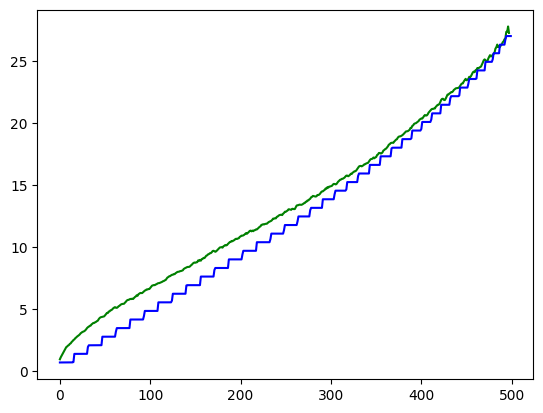

In [24]:
#k=8
model.eval()
ground_truth=[]
preds=[]
losses=[]
with torch.no_grad():
    for im_tst,speed_tst in test_dataloader:
    # Forward pass
        outputs_tst = model(im_tst.to(device))
        #loss2 = criterion(outputs_tst, speed_tst.to(device))
        out_vecs=[]
        for k in range(len(outputs_tst)):
            out = outputs_tst[k,:].cpu().detach().squeeze()
            #
            
            def rolling_mean(matrix, window):
                df = pd.DataFrame(matrix)
                return df.rolling(window=window).mean().dropna().to_numpy()
            out_mean = rolling_mean(out,3)
            #out_mean=out_mean[out_mean>0]
            out_mean[out_mean<0]=0.0001
            out_vecs.append(out_mean)
       # losses.append(loss2.item())
        preds.append(out_vecs)
        ground_truth.append(speed_tst.numpy())
    # for i in out:
#     if (i>.03)&(count<400):
#         out[:,count
#     count+=1
plt.plot(out_mean, c='g')
plt.plot(speed_tst[k], c='b')

2.2702453577119743

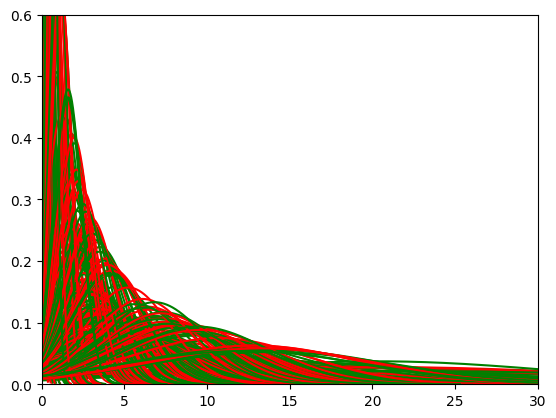

In [25]:
len(preds)
from scipy.stats import norm

losses=[]
full_preds=[]
criterion = nn.MSELoss()
#ground_truth[-1].shape
for i in range(len(preds)):
    for j in range(len(preds[i])):
        pred = preds[i][j]#(.00*preds1[i][j]+0.3*preds2[i][j]+.7*preds3[i][j])
        a,b = norm.fit(pred)

        xtorch= np.linspace(norm.ppf(0.0001, a,b),
                        norm.ppf(0.9999, a,b), target_length)
        distr_torch=norm.pdf(xtorch, a,b)
        plt.plot(xtorch,distr_torch,c='r')
        
        a,b = norm.fit(ground_truth[i][j,:])
        xtorch= np.linspace(norm.ppf(0.0001, a,b),
                        norm.ppf(0.9999, a,b), target_length)
        distr_torch=norm.pdf(xtorch, a,b)
        plt.plot(xtorch,distr_torch,c='g')
        plt.xlim([0,30])
        plt.ylim([0,.6])
        full_preds.append(pred)
        loss = criterion(torch.tensor(pred).squeeze(), torch.tensor(ground_truth[i][j,:-2]))
        losses.append(loss.item())
        #plt.title('Loss = '+str(loss.item()))
        #plt.show()
        
np.mean(losses)
#ground_truth[0].shape

In [26]:
flat_pred = np.vstack(full_preds)
flat_pred=np.reshape(flat_pred,[-1,])
flat_pred.shape

(85656,)

In [27]:
flat_gt = np.vstack(ground_truth)
flat_gt=np.reshape(flat_gt,[-1,])
flat_gt.shape

(86000,)

In [23]:
torch.save(model.state_dict(), 'speed_classifier_regnetx120_448px_disp_all')

3.877841068775001
1.1627231720353304 -0.1893985399970358 2.9045164367367065
3.922090895474483
1.1896857 -0.14339327067084198 2.8757985


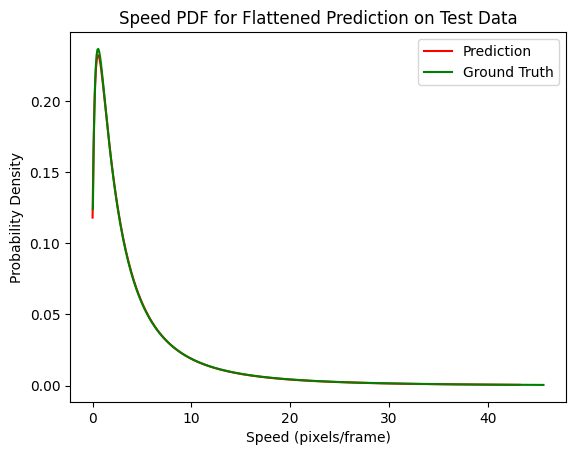

In [28]:
a,b,c = lognorm.fit(flat_pred)
#c=c+.4
#a=a+.1
# Generate points for plotting the fitted distribution
xtorch= np.linspace(lognorm.ppf(0.01, a,b,c),
                lognorm.ppf(0.99, a,b,c), target_length)

distr_torch=lognorm.pdf(xtorch, a,b,c)
print(a+b+c)
print(a,b,c)
# scales[i,:] = torch.tensor([a,b,c])
plt.plot(xtorch,distr_torch,c='r')

# a = (3*a_tst[k].cpu().detach().numpy()+a)/4
# b = (3*b_tst[k].cpu().detach().numpy()+b)/4
# c = (3*c_tst[k].cpu().detach().numpy()+c)/4
# print(a+b+c)
# print(a,b,c)
# xtorch= np.linspace(lognorm.ppf(0.01, a,b,c),
#                 lognorm.ppf(0.99, a,b,c), target_length)

# distr_torch=lognorm.pdf(xtorch, a,b,c)
# print(a,b,c)
# # scales[i,:] = torch.tensor([a,b,c])
# plt.plot(xtorch,distr_torch,c='b')

a,b,c = lognorm.fit(flat_gt)
    
# Generate points for plotting the fitted distribution
xtorch= np.linspace(lognorm.ppf(0.01, a,b,c),
                lognorm.ppf(0.99, a,b,c), target_length)

distr_torch=lognorm.pdf(xtorch, a,b,c)
print(a+b+c)
print(a,b,c)

# scales[i,:] = torch.tensor([a,b,c])
plt.plot(xtorch,distr_torch,c='g')
plt.title('Speed PDF for Flattened Prediction on Test Data')
plt.xlabel('Speed (pixels/frame)')
plt.ylabel('Probability Density')
plt.legend(['Prediction', 'Ground Truth'])


In [52]:
F.softmax(outputs_tst,dim=1)

tensor([[0.5696, 0.2168, 0.2136],
        [0.2121, 0.2122, 0.5757],
        [0.5758, 0.2121, 0.2121],
        [0.5759, 0.2121, 0.2120]], device='cuda:0')

In [53]:
speed_tst

tensor([[1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.]])